In [1]:
import numpy as np
from io import StringIO
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import pandas_datareader
import datetime
import pandas_datareader.data as web
from scipy.stats import norm
import yfinance as yf
import cufflinks as cf
cf.go_offline()

In [6]:
dfticker = pd.read_csv("//Users//sjacob//stocks//QUALITYGRWOTHJAN24.csv", index_col = False)
tickers = []
length = len(dfticker)
for i in range(0,length):
    tickers.append(dfticker['Ticker'][i]+".NS")

In [7]:
data = pd.DataFrame()

data = yf.download(tickers,period="4y")
     
data = data['Adj Close']
        
data.to_csv("//Users//sjacob//stocks//QGRJUNE2023.csv")
data.dropna()

[*********************100%***********************]  196 of 196 completed


1 Failed download:
['EICHERMOT.NS']: Exception('%ticker%: No price data found, symbol may be delisted (period=4y)')


,20MICRONS.NS,ABBOTINDIA.NS,ACE.NS,ADANIPOWER.NS,ADORWELD.NS,AGARIND.NS,AHLUCONT.NS,AIAENG.NS,AJANTPHARM.NS,ALKYLAMINE.NS,...,UTTAMSUGAR.NS,VADILALIND.NS,VIDHIING.NS,VINATIORGA.NS,VINYLINDIA.NS,VOLTAMP.NS,VSSL.NS,WIPRO.NS,WONDERLA.NS,XPROINDIA.NS
Date,,,,,,,,,,,,,,,,,,,,,


In [8]:
returns = np.log(data / data.shift(1))
vols = returns.std() * 252 ** 0.5 *100
vols

20MICRONS.NS     54.377822
ABBOTINDIA.NS    26.356806
ACE.NS           51.709842
ADANIPOWER.NS    57.938114
ADORWELD.NS      47.169310
                   ...    
VOLTAMP.NS       43.166991
VSSL.NS          47.938973
WIPRO.NS         29.404917
WONDERLA.NS      42.674250
XPROINDIA.NS     58.062713
Length: 196, dtype: float64

In [9]:
annual_returns = returns.mean() * 252 * 100
annual_returns

20MICRONS.NS      42.142616
ABBOTINDIA.NS     17.525172
ACE.NS            61.456500
ADANIPOWER.NS     55.421510
ADORWELD.NS       42.573858
                    ...    
VOLTAMP.NS        43.925613
VSSL.NS           44.171981
WIPRO.NS          15.430715
WONDERLA.NS       31.870984
XPROINDIA.NS     108.867148
Length: 196, dtype: float64

In [10]:
import numpy as np
import pandas as pd
from scipy.stats import norm
import pandas_datareader.data as web
import datetime
import math

class ValueAtRiskMonteCarlo:
    
    def __init__(self, S, mu, sigma, c, n, iterations):
        self.S = S
        self.mu = mu
        self.sigma = sigma
        self.c = c
        self.n = n
        self.iterations = iterations 

    def simulation(self):
        stock_data = np.zeros([self.iterations, 1])	
        rand = np.random.normal(0, 1, [1, self.iterations])

        #equation for the S(t) stock price
        stock_price = self.S*np.exp(self.n*(self.mu - 0.5*self.sigma**2)+self.sigma*np.sqrt(self.n)*rand)
        #we have to sort the stock prices to determine the percentile
        stock_price = np.sort(stock_price)

        #it depends on the confidence level: 95% -> 5 and 99% -> 1
        percentile = np.percentile(stock_price,(1-self.c)*100)

        return self.S-percentile

In [11]:

df = pd.DataFrame(columns = ['Ticker', 'Cov_mar','Market_var','Beta','Volatility%','Return%','CV','Sharp Ratio','CAGR','MAXDD%','Value at Risk']) 
data = pd.DataFrame()
data['^BSESN'] = yf.download('^BSESN',period="3y").Close

for t in tickers:
    try:
        data[t] = yf.download(t,period="3y").Close 
    except:
        continue
    sec_returns = np.log( data / data.shift(1) )
    cov = sec_returns.cov()*252
    cov_with_market = cov[t][0]
 
      
    dr = data[t].pct_change()
    dcum = (1 + dr).cumprod()
    n = len(data)/252
    CAGR = ((dcum[-1])**(1/n) - 1)*100
      
 
    
    droll = dcum.cummax()
    ddw = droll - dcum
    ddmax = ddw/droll
    max_dd = (ddmax.max())*100
   
 

    market_var = sec_returns['^BSESN'].var() * 252

    returns = np.log(data[t] / data[t].shift(1))
    MSFT_beta = cov_with_market / market_var
    MSFT_er = returns.mean()*252
    Sharp = (MSFT_er - 0.05) / (sec_returns[t].std() * 252 ** 0.5)
   

    #returns = np.log(data[t] / data[t].shift(1))
    vols = returns.std() * 252 ** 0.5 *100
    annual_returns = returns.mean() * 252 * 100
    CV = (vols/annual_returns)*100
    S = 100000    #this is the investment (stocks or whatever)
    c=0.95   #condifence level: this time it is 99%
    n = 730   #1 day 
    iterations = 100000 #number of paths in the Monte-Carlo simulation
    mu = np.mean(returns)
    sigma = np.mean(returns.std())

    model = ValueAtRiskMonteCarlo(S,mu,sigma,c,n,iterations)
    val = model.simulation()
    df.loc[len(df.index)] = [t,cov_with_market,market_var,MSFT_beta,vols,annual_returns,CV,Sharp,CAGR,max_dd,val] 
    
    
  

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%********

/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/4031674041.py:7: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



In [12]:
df1 = df[(df['CAGR']>10 ) & (df['Return%']>10)]
df2 = df1.sort_values(by='Return%', ascending=False)
df2

,Ticker,Cov_mar,Market_var,Beta,Volatility%,Return%,CV,Sharp Ratio,CAGR,MAXDD%,Value at Risk
51,XPROINDIA.NS,0.017242,0.021845,0.789291,53.910457,129.072765,41.767492,2.301460,262.910397,49.866774,-511003.735482
119,APARINDS.NS,0.015236,0.021845,0.697473,49.707619,93.379926,53.231590,1.777996,154.095266,28.222426,-158635.907358
35,PGEL.NS,0.019744,0.021845,0.903860,50.980641,91.529595,55.698532,1.697303,149.443122,38.169383,-133632.102989
128,GOODLUCK.NS,0.019748,0.021845,0.904033,50.066230,91.286588,54.845110,1.723449,148.838510,38.299220,-143844.120436
79,GRAVITA.NS,0.023698,0.021845,1.084840,51.100833,86.807848,58.866605,1.600910,137.953952,38.160470,-101382.587574
...,...,...,...,...,...,...,...,...,...,...,...
123,HCLTECH.NS,0.018799,0.021845,0.860583,23.936404,11.801398,202.826854,0.284145,12.508064,34.976435,33613.021696
40,BRITANNIA.NS,0.009191,0.021845,0.420768,19.658707,11.650657,168.734746,0.338306,12.338825,24.967270,23783.782639
78,LTIM.NS,0.021935,0.021845,1.004142,32.674899,11.482817,284.554728,0.198404,12.150688,49.433663,52504.724648
81,EICHERMOT.NS,0.020037,0.021845,0.917257,27.263111,11.057727,246.552580,0.222195,11.675599,25.920349,42122.870815


In [13]:
df2.to_csv("//Users//sjacob//stocks//QUALITYJAN24.csv")

In [14]:
pf_data = pd.DataFrame()
for t in df1["Ticker"]:
    pf_data[t] =  yf.download(t,period="3y").Close 

log_returns = np.log(pf_data / pf_data.shift(1))
num_assets = len(df1["Ticker"])
num_assets
weights = np.random.random(num_assets)
weights /= np.sum(weights)
np.sum(weights * log_returns.mean()) * 252
np.dot(weights.T, np.dot(log_returns.cov() * 252, weights))
np.sqrt(np.dot(weights.T,np.dot(log_returns.cov() * 252, weights)))
pfolio_returns = []
pfolio_volatilities = []
wts = []
for x in range (1000):
    weights = np.random.random(num_assets)
    weights /= np.sum(weights)
    pfolio_returns.append(np.sum(weights * log_returns.mean()) * 252)
    pfolio_volatilities.append(np.sqrt(np.dot(weights.T,np.dot(log_returns.cov() * 252, weights))))
    wts.append(weights)
pfolio_returns = np.array(pfolio_returns)
pfolio_volatilities = np.array(pfolio_volatilities)
wts= np.array(wts)
pfolio_returns, pfolio_volatilities
portfolios = pd.DataFrame({'Return': pfolio_returns, 'Volatility': pfolio_volatilities})
#portfolios.plot(x='Volatility', y='Return', kind='scatter', figsize=(10, 6));
#plt.xlabel('Expected Volatility')
#plt.ylabel('Expected Return')


portfolios.iplot(kind="scatter",
              x="Volatility", y='Return',
              mode='markers',
              xTitle="Volatility", yTitle="Return",
              title="========Volatility-------Return=========================",theme="solar")

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%********

/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed

/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed

/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed

/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



[*********************100%***********************]  1 of 1 completed


/var/folders/jx/qw4vpgyd2gxg8zhm3nm041j40000gp/T/ipykernel_13225/3320588602.py:3: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



In [15]:
import numpy as np
import pandas as pd
from scipy.stats import norm
import pandas_datareader.data as web
import datetime
import math

class ValueAtRiskMonteCarlo:
    
    def __init__(self, S, mu, sigma, c, n, iterations):
        self.S = S
        self.mu = mu
        self.sigma = sigma
        self.c = c
        self.n = n
        self.iterations = iterations 

    def simulation(self):
        stock_data = np.zeros([self.iterations, 1])	
        rand = np.random.normal(0, 1, [1, self.iterations])

        #equation for the S(t) stock price
        stock_price = self.S*np.exp(self.n*(self.mu - 0.5*self.sigma**2)+self.sigma*np.sqrt(self.n)*rand)
        #we have to sort the stock prices to determine the percentile
        stock_price = np.sort(stock_price)

        #it depends on the confidence level: 95% -> 5 and 99% -> 1
        percentile = np.percentile(stock_price,(1-self.c)*100)

        return self.S-percentile

if __name__ == "__main__":
    S = 100000    #this is the investment (stocks or whatever)
    c=0.95   #condifence level: this time it is 99%
    n = 730   #1 day 
    iterations = 100000 #number of paths in the Monte-Carlo simulation

    #historical data to approximate mean and standard deviation
    d = {}

    #download stock related data from Yahoo Finance
    for t in df1["Ticker"]:
        citi = yf.download(t,period="3y")
           #we can use pct_change() to calculate daily returns
        citi['returns'] = citi['Close'].pct_change()

    #we can assume daily returns to be normally sidtributed: mean and variance (standard deviation)
    #can describe the process
        mu = np.mean(citi['returns'])
        sigma = np.std(citi['returns'])

        model = ValueAtRiskMonteCarlo(S,mu,sigma,c,n,iterations)
        val = model.simulation()
        d[t] = val
        print("VALUE AT RSIK for {} is".format(t))
        print('Value at risk with Monte-Carlo simulation in INR: %0.2f' % val)
    print("The minimum value at risk for the portofolios are:")
    print(min(d.values()))

[*********************100%***********************]  1 of 1 completed
VALUE AT RSIK for ATGL.NS is
Value at risk with Monte-Carlo simulation in INR: 46495.46
[*********************100%***********************]  1 of 1 completed
VALUE AT RSIK for ASTRAZEN.NS is
Value at risk with Monte-Carlo simulation in INR: 36244.50
[*********************100%***********************]  1 of 1 completed
VALUE AT RSIK for DIXON.NS is
Value at risk with Monte-Carlo simulation in INR: 26084.51
[*********************100%***********************]  1 of 1 completed
VALUE AT RSIK for PIDILITIND.NS is
Value at risk with Monte-Carlo simulation in INR: 20098.08
[*********************100%***********************]  1 of 1 completed
VALUE AT RSIK for ASTRAL.NS is
Value at risk with Monte-Carlo simulation in INR: 28595.69
[*********************100%***********************]  1 of 1 completed
VALUE AT RSIK for TITAN.NS is
Value at risk with Monte-Carlo simulation in INR: -15035.16
[*********************100%*****************

[*********************100%***********************]  1 of 1 completed
VALUE AT RSIK for CENTURYPLY.NS is
Value at risk with Monte-Carlo simulation in INR: -17110.46
[*********************100%***********************]  1 of 1 completed
VALUE AT RSIK for SUNPHARMA.NS is
Value at risk with Monte-Carlo simulation in INR: -14401.00
[*********************100%***********************]  1 of 1 completed
VALUE AT RSIK for BLUEDART.NS is
Value at risk with Monte-Carlo simulation in INR: 17923.90
[*********************100%***********************]  1 of 1 completed
VALUE AT RSIK for BEL.NS is
Value at risk with Monte-Carlo simulation in INR: -66488.70
[*********************100%***********************]  1 of 1 completed
VALUE AT RSIK for CYIENT.NS is
Value at risk with Monte-Carlo simulation in INR: -38169.64
[*********************100%***********************]  1 of 1 completed
VALUE AT RSIK for ELGIEQUIP.NS is
Value at risk with Monte-Carlo simulation in INR: 22523.77
[*********************100%*******

[*********************100%***********************]  1 of 1 completed
VALUE AT RSIK for NUCLEUS.NS is
Value at risk with Monte-Carlo simulation in INR: 38536.36
[*********************100%***********************]  1 of 1 completed
VALUE AT RSIK for MPHASIS.NS is
Value at risk with Monte-Carlo simulation in INR: 40448.26
[*********************100%***********************]  1 of 1 completed
VALUE AT RSIK for PITTIENG.NS is
Value at risk with Monte-Carlo simulation in INR: -177191.03
[*********************100%***********************]  1 of 1 completed
VALUE AT RSIK for POWERMECH.NS is
Value at risk with Monte-Carlo simulation in INR: -187330.52
[*********************100%***********************]  1 of 1 completed
VALUE AT RSIK for MARKSANS.NS is
Value at risk with Monte-Carlo simulation in INR: 26348.56
[*********************100%***********************]  1 of 1 completed
VALUE AT RSIK for APARINDS.NS is
Value at risk with Monte-Carlo simulation in INR: -255157.74
[*********************100%***

[*********************100%***********************]  1 of 1 completed
VALUE AT RSIK for PSPPROJECT.NS is
Value at risk with Monte-Carlo simulation in INR: 37670.37
[*********************100%***********************]  1 of 1 completed
VALUE AT RSIK for COROMANDEL.NS is
Value at risk with Monte-Carlo simulation in INR: 31521.34
[*********************100%***********************]  1 of 1 completed
VALUE AT RSIK for CIGNITITEC.NS is
Value at risk with Monte-Carlo simulation in INR: 11080.54
[*********************100%***********************]  1 of 1 completed
VALUE AT RSIK for DCMSHRIRAM.NS is
Value at risk with Monte-Carlo simulation in INR: 22657.92
[*********************100%***********************]  1 of 1 completed
VALUE AT RSIK for GNA.NS is
Value at risk with Monte-Carlo simulation in INR: 17850.73
[*********************100%***********************]  1 of 1 completed
VALUE AT RSIK for RITES.NS is
Value at risk with Monte-Carlo simulation in INR: 23991.87
[*********************100%********

In [16]:
for key,value in d.items():
    print(" The Value at risk per 1L invested in stock {} is {:0.2f}".format(key,value))

 The Value at risk per 1L invested in stock ATGL.NS is 46495.46
 The Value at risk per 1L invested in stock ASTRAZEN.NS is 36244.50
 The Value at risk per 1L invested in stock DIXON.NS is 26084.51
 The Value at risk per 1L invested in stock PIDILITIND.NS is 20098.08
 The Value at risk per 1L invested in stock ASTRAL.NS is 28595.69
 The Value at risk per 1L invested in stock TITAN.NS is -15035.16
 The Value at risk per 1L invested in stock JWL.NS is -157748.28
 The Value at risk per 1L invested in stock BLS.NS is -171026.02
 The Value at risk per 1L invested in stock FACT.NS is -44054.80
 The Value at risk per 1L invested in stock POLYMED.NS is 3840.03
 The Value at risk per 1L invested in stock HAVELLS.NS is 38318.28
 The Value at risk per 1L invested in stock TATAELXSI.NS is -40946.05
 The Value at risk per 1L invested in stock CDSL.NS is -25585.78
 The Value at risk per 1L invested in stock SOLARINDS.NS is -122861.02
 The Value at risk per 1L invested in stock NELCO.NS is 1646.53
 Th

In [17]:
df2.reset_index(inplace = True)

In [18]:
import plotly.graph_objects as go

# Assuming you have already created the 'df2' DataFrame

fig = go.Figure(data=go.Scatter(x=df2["CV"], y=df2["Value at Risk"], mode='markers'))
fig.update_layout(title="========VOL------CV========================",
                  xaxis_title="CV", yaxis_title="VAR",
                  xaxis=dict(title="Volatility"),
                  yaxis=dict(title="CV"),
                  showlegend=False,
                  template="plotly_dark")  # Choose a theme here if you'd like, e.g., "plotly", "plotly_white", etc.

fig.show()

In [19]:
import plotly.graph_objects as go

# Assuming you have already created the 'df2' DataFrame

fig = go.Figure(data=go.Scatter(x=df2["Return%"], y=df2["Volatility%"], mode='markers'))
fig.update_layout(title="========VOL------CV========================",
                  xaxis_title="Volatility", yaxis_title="CV",
                  xaxis=dict(title="Volatility"),
                  yaxis=dict(title="CV"),
                  showlegend=False,
                  template="plotly_dark")  # Choose a theme here if you'd like, e.g., "plotly", "plotly_white", etc.

fig.show()

In [20]:
import plotly.graph_objects as go

# Assuming you have already created the 'df2' DataFrame

fig = go.Figure(data=go.Scatter(x=df2["Return%"], y=df2["CV"], mode='markers'))
fig.update_layout(title="========VOL------CV========================",
                  xaxis_title="Volatility", yaxis_title="CV",
                  xaxis=dict(title="Volatility"),
                  yaxis=dict(title="CV"),
                  showlegend=False,
                  template="plotly_dark")  # Choose a theme here if you'd like, e.g., "plotly", "plotly_white", etc.

fig.show()

In [21]:
import plotly.graph_objects as go

# Assuming you have already created the 'df2' DataFrame

fig = go.Figure(data=go.Scatter(x=df2["Volatility%"], y=df2["Value at Risk"], mode='markers'))
fig.update_layout(title="========VOL------CV========================",
                  xaxis_title="Volatility", yaxis_title="Value at Risk",
                  xaxis=dict(title="Volatility"),
                  yaxis=dict(title="VAR"),
                  showlegend=False,
                  template="plotly_dark")  # Choose a theme here if you'd like, e.g., "plotly", "plotly_white", etc.

fig.show()

In [22]:
norm = data.div(data.iloc[0,:]).mul(100)
norm.iplot(title="Comparision Analysis",xTitle='Date',yTitle="Normalized Price", fill = True, theme="pearl")

In [23]:
norm.iplot(title="Comparision Analysis",xTitle='Date',yTitle="Normalized Price", fill = True, theme="pearl")

In [24]:
ret = data.pct_change().dropna()

ret.iplot(kind="hist", bins=50, histnorm=None,theme="pearl")

In [25]:
import plotly.graph_objects as go

# Assuming you have already created the 'df2' DataFrame

fig = go.Figure(data=go.Scatter(x=df2["Volatility%"], y=df2["CV"], mode='markers'))
fig.update_layout(title="========VOL------CV========================",
                  xaxis_title="Volatility", yaxis_title="CV",
                  xaxis=dict(title="Volatility"),
                  yaxis=dict(title="CV"),
                  showlegend=False,
                  template="plotly_dark")  # Choose a theme here if you'd like, e.g., "plotly", "plotly_white", etc.

fig.show()

In [26]:
import plotly.graph_objects as go

# Assuming you have already created the 'df2' DataFrame
# Assuming you have a column in 'df2' named 'Ticker' for custom labels

fig = go.Figure()

scatter_trace = go.Scatter(
    x=df2["Volatility%"],
    y=df2["CV"],
    mode='markers+text',  # Use 'markers+text' mode to show text labels on markers
    text=df2["Ticker"],   # Use the 'Ticker' column as the label for each data point
    textposition="bottom center",  # Position of the text relative to the markers
    marker=dict(size=10)  # Adjust marker size as needed
)

fig.add_trace(scatter_trace)

fig.update_layout(
    title="========VOL------CV========================",
    xaxis_title="Volatility",
    yaxis_title="CV",
    xaxis=dict(title="Volatility"),
    yaxis=dict(title="CV"),
    showlegend=False,
    template="plotly_dark"  # Choose a theme here if you'd like, e.g., "plotly", "plotly_white", etc.
)

fig.show()

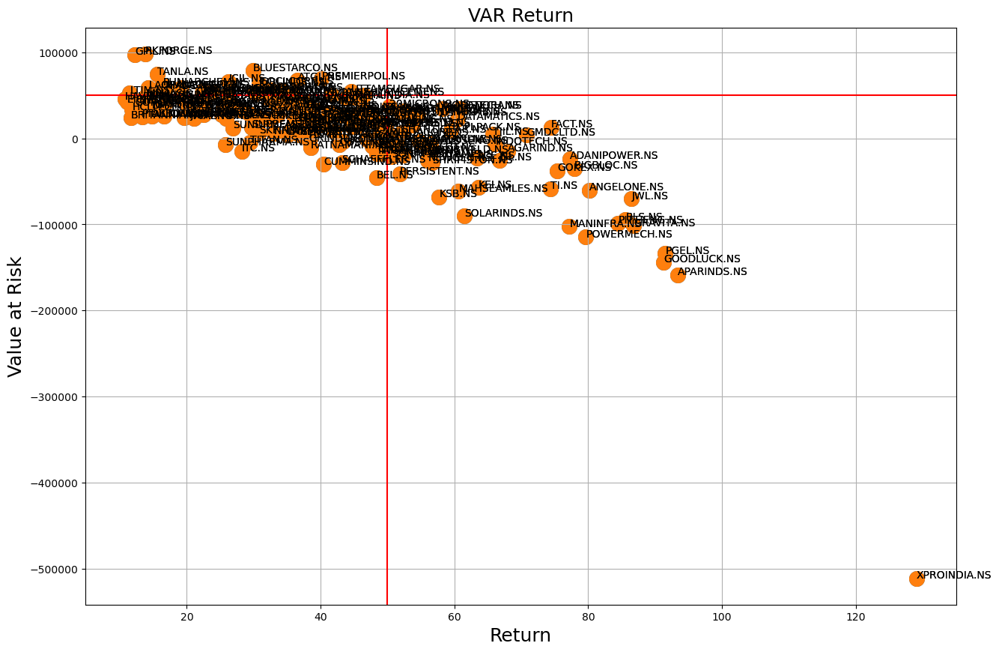

In [27]:
plt.figure(figsize=[15,10])
x= df2['Return%']
y = df2['Value at Risk']
annotations = df2["Ticker"]
plt.grid(True)
plt.title('VAR Return', fontsize=18, color='black')
plt.xlabel("Return",fontsize=18, color='black')
plt.ylabel("Value at Risk", fontsize=18, color='black') 
plt.scatter(x, y,s=200 )
for i, label in enumerate(annotations):
    plt.annotate(label, (x[i], y[i]))
plt.scatter(x, y,s=200 )
for i, label in enumerate(annotations):
    plt.annotate(label, (x[i], y[i]))
plt.axvline(x = 50, color = 'r', label = 'axvline - full height')
plt.axhline(y=50000, color='r', linestyle='-')
plt.show()

plt.show()

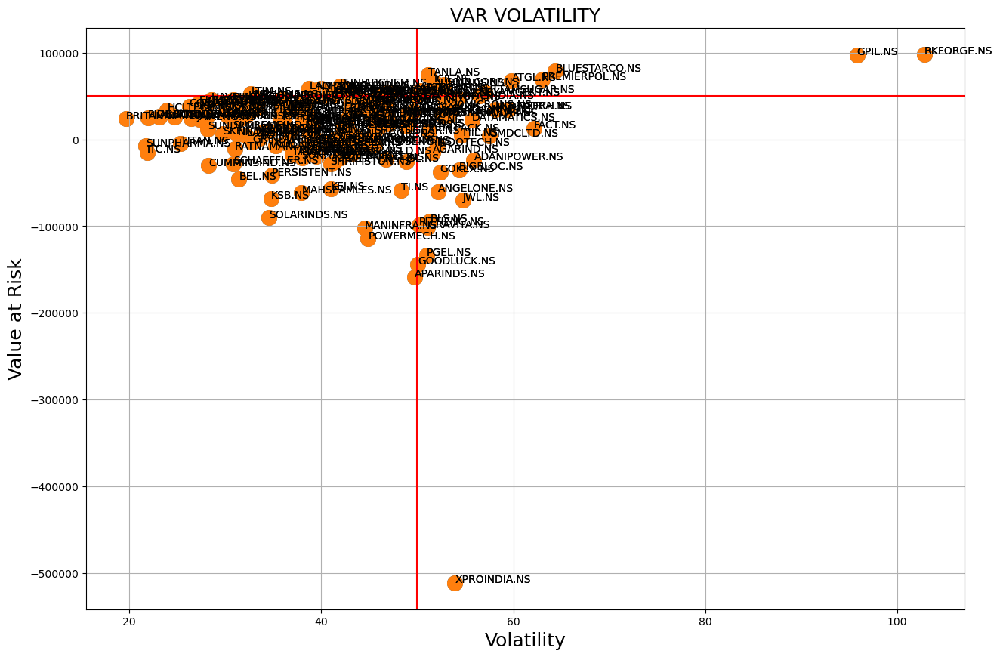

In [28]:
plt.figure(figsize=[15,10])
x= df2['Volatility%']
y = df2['Value at Risk']
annotations = df2["Ticker"]
plt.grid(True)
plt.title('VAR VOLATILITY', fontsize=18, color='black')
plt.xlabel("Volatility",fontsize=18, color='black')
plt.ylabel("Value at Risk", fontsize=18, color='black') 
plt.scatter(x, y,s=200 )
for i, label in enumerate(annotations):
    plt.annotate(label, (x[i], y[i]))
plt.scatter(x, y,s=200 )
for i, label in enumerate(annotations):
    plt.annotate(label, (x[i], y[i]))
plt.axvline(x = 50, color = 'r', label = 'axvline - full height')
plt.axhline(y=50000, color='r', linestyle='-')
plt.show()

plt.show()

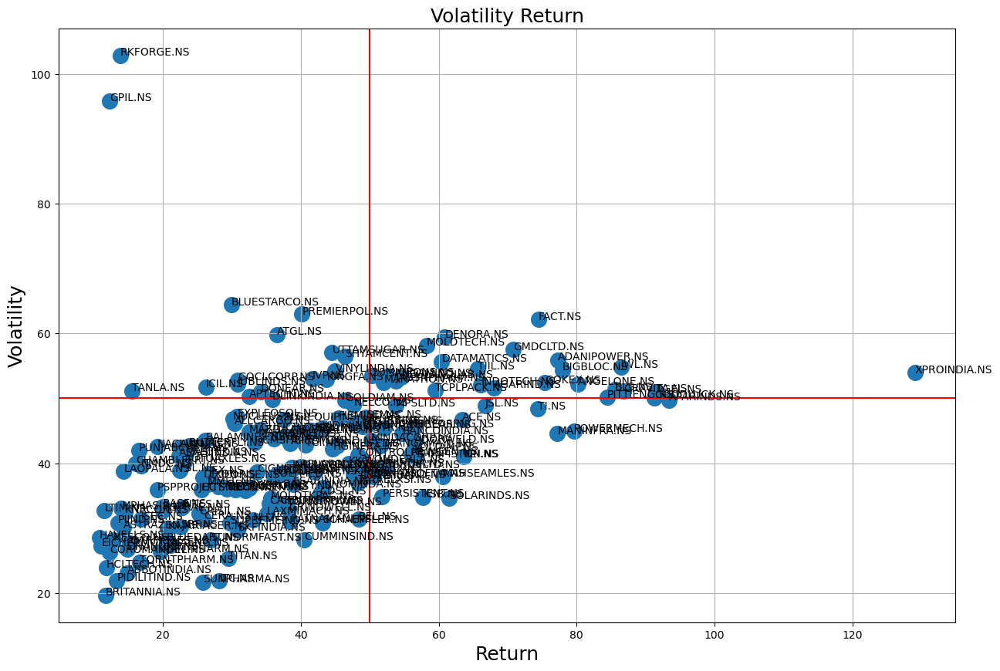

In [29]:
plt.figure(figsize=[15,10])
x= df2['Return%']
y = df2['Volatility%']
annotations = np.array(df2["Ticker"])
plt.grid(True)
plt.title('Volatility Return', fontsize=18, color='black')
plt.xlabel("Return",fontsize=18, color='black')
plt.ylabel("Volatility", fontsize=18, color='black') 
plt.scatter(x, y,s=200 )
i=0
for labels in annotations:
    plt.annotate(labels, (x[i], y[i]))
    i=i+1
plt.axvline(x = 50, color = 'r', label = 'axvline - full height')
plt.axhline(y=50, color='r', linestyle='-')
plt.show()

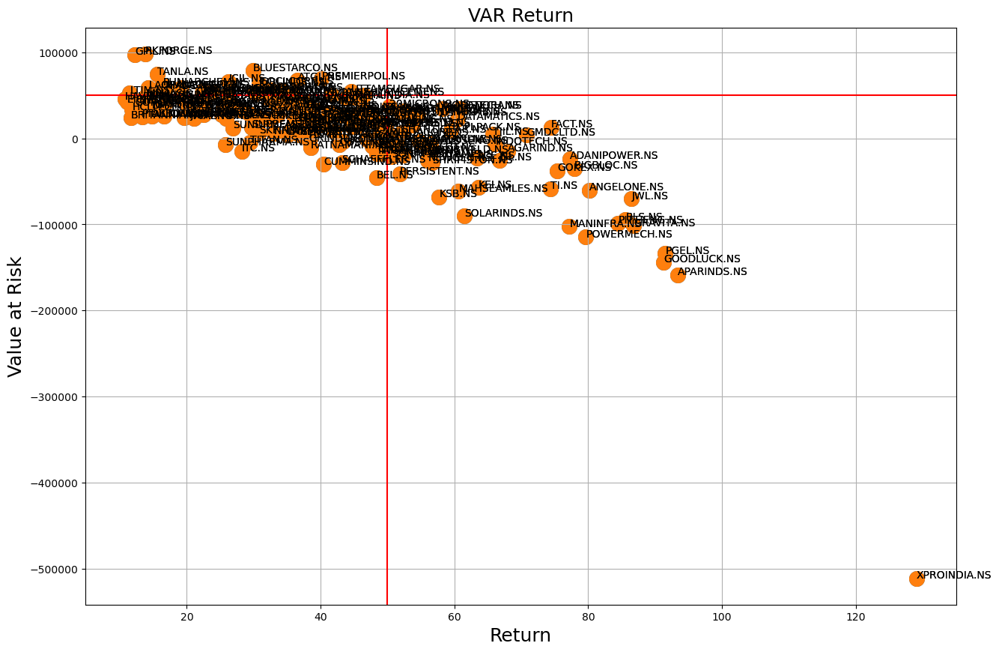

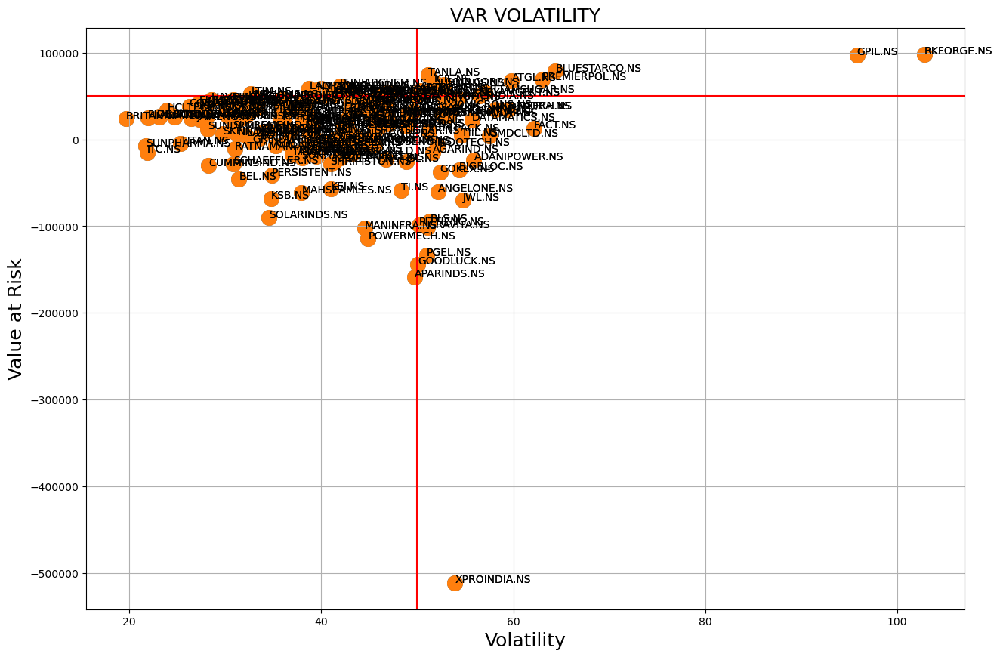

In [30]:
plt.figure(figsize=[15,10])
x= df2['Return%']
y = df2['Value at Risk']
annotations = df2["Ticker"]
plt.grid(True)
plt.title('VAR Return', fontsize=18, color='black')
plt.xlabel("Return",fontsize=18, color='black')
plt.ylabel("Value at Risk", fontsize=18, color='black') 
plt.scatter(x, y,s=200 )
for i, label in enumerate(annotations):
    plt.annotate(label, (x[i], y[i]))
plt.scatter(x, y,s=200 )
for i, label in enumerate(annotations):
    plt.annotate(label, (x[i], y[i]))
plt.axvline(x = 50, color = 'r', label = 'axvline - full height')
plt.axhline(y=50000, color='r', linestyle='-')
plt.show()

plt.figure(figsize=[15,10])
x= df2['Volatility%']
y = df2['Value at Risk']
annotations = df2["Ticker"]
plt.grid(True)
plt.title('VAR VOLATILITY', fontsize=18, color='black')
plt.xlabel("Volatility",fontsize=18, color='black')
plt.ylabel("Value at Risk", fontsize=18, color='black') 
plt.scatter(x, y,s=200 )
for i, label in enumerate(annotations):
    plt.annotate(label, (x[i], y[i]))
plt.scatter(x, y,s=200 )
for i, label in enumerate(annotations):
    plt.annotate(label, (x[i], y[i]))
plt.axvline(x = 50, color = 'r', label = 'axvline - full height')
plt.axhline(y=50000, color='r', linestyle='-')
plt.show()

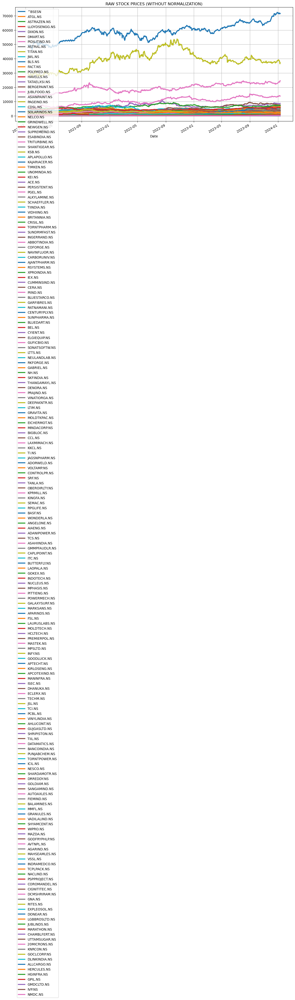

In [31]:
stocks_df = data
def show_plot(df, fig_title):
  df.plot(x = 'Date', figsize = (15,7), linewidth = 3, title = fig_title)
  plt.grid()
  plt.show()
stocks_df = stocks_df.reset_index()
show_plot(stocks_df, 'RAW STOCK PRICES (WITHOUT NORMALIZATION)')

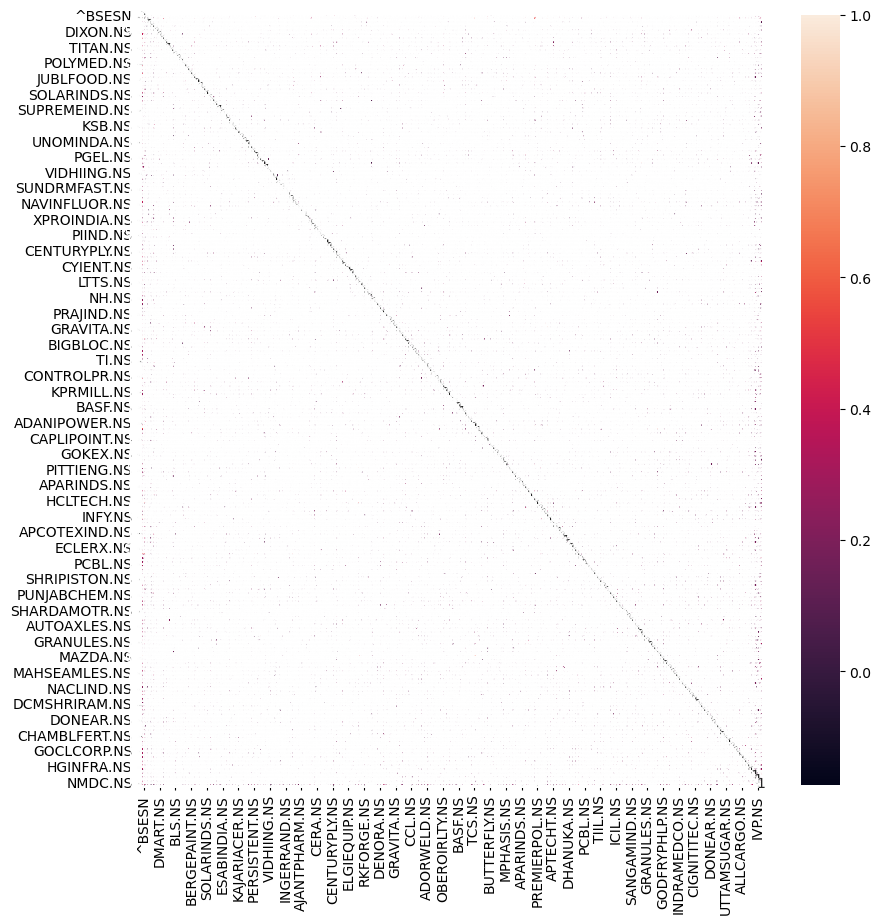

In [32]:
def daily_return(df):
  df_daily_return = df.copy()

  # Loop through each stock (while ignoring time columns with index 0)
  for i in df.columns[1:]:
    
    # Loop through each row belonging to the stock
    for j in range(1, len(df)):

      # Calculate the percentage of change from the previous day
      df_daily_return[i][j] = ((df[i][j]- df[i][j-1])/df[i][j-1]) * 100
    
    # set the value of first row to zero since the previous value is not available
    df_daily_return[i][0] = 0
  
  return df_daily_return

# Get the daily returns 
stocks_daily_return = daily_return(stocks_df)

# Daily Return Correlation
cm = stocks_daily_return.drop(columns = ['Date']).corr()

import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from copy import copy
from scipy import stats
import plotly.express as px
import plotly.figure_factory as ff
import plotly.graph_objects as go
plt.figure(figsize=(10, 10))
ax = plt.subplot()
sns.heatmap(cm, annot = True, ax = ax);

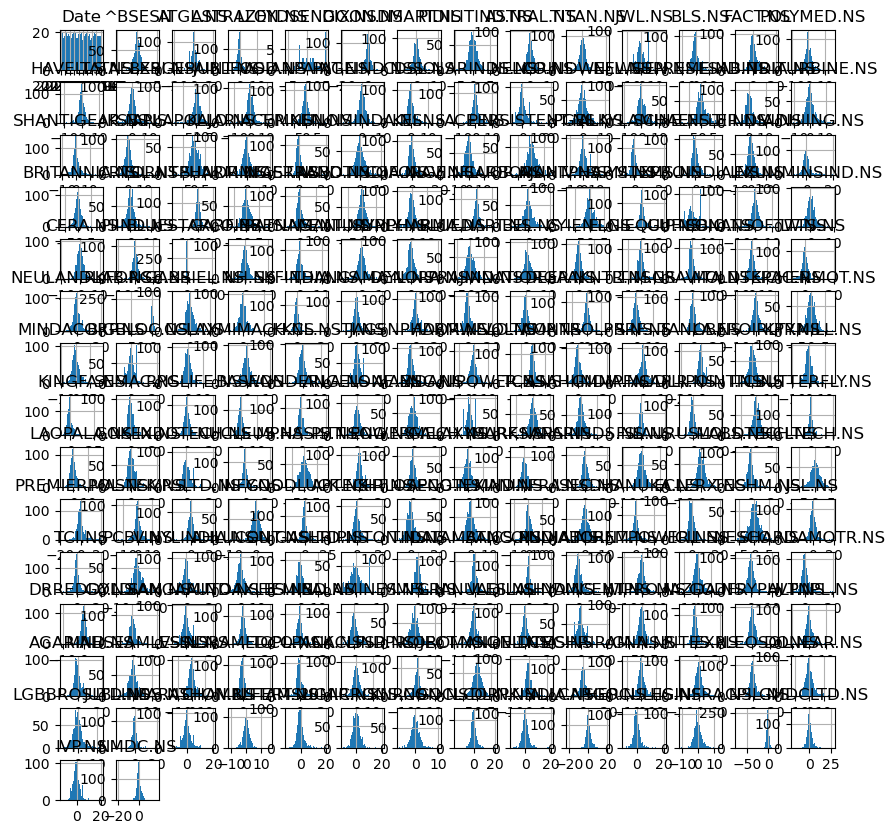

In [33]:
# Histogram of daily returns
# Stock returns are normally distributed with zero mean 
# Notice how Tesla Standard deviation is high indicating a more volatile stock
stocks_daily_return.hist(figsize=(10, 10), bins = 40);

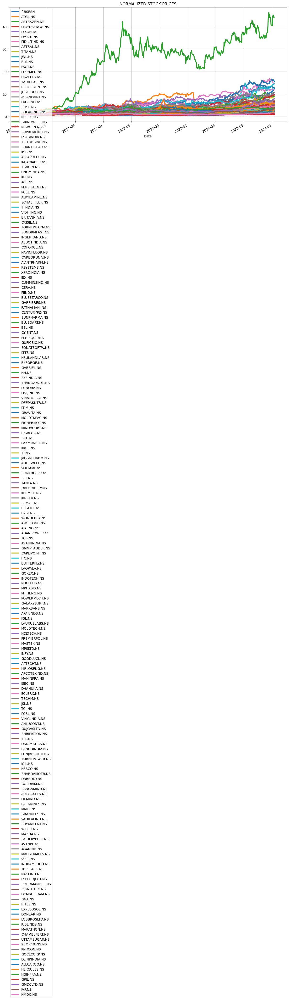

In [34]:
# Function to normalize the prices based on the initial price
# The function simply divides every stock by it's price at the start date (i.e.: Date = 2012-01-12)	
def normalize(df):
  x = df.copy()

  # Loop through each stock (while ignoring time columns with index 0)
  for i in x.columns[1:]:
    x[i] = x[i]/x[i][0]
  return x

# Plot normalized data
# Notice the massive gains in Tesla Stock compared to Amazon (second place)
show_plot(normalize(stocks_df), 'NORMALIZED STOCK PRICES')

In [35]:
patterns = {
    'CDL2CROWS':'Two Crows',
    'CDL3BLACKCROWS':'Three Black Crows',
    'CDL3INSIDE':'Three Inside Up/Down',
    'CDL3LINESTRIKE':'Three-Line Strike',
    'CDL3OUTSIDE':'Three Outside Up/Down',
    'CDL3STARSINSOUTH':'Three Stars In The South',
    'CDL3WHITESOLDIERS':'Three Advancing White Soldiers',
    'CDLABANDONEDBABY':'Abandoned Baby',
    'CDLADVANCEBLOCK':'Advance Block',
    'CDLBELTHOLD':'Belt-hold',
    'CDLBREAKAWAY':'Breakaway',
    'CDLCLOSINGMARUBOZU':'Closing Marubozu',
    'CDLCONCEALBABYSWALL':'Concealing Baby Swallow',
    'CDLCOUNTERATTACK':'Counterattack',
    'CDLDARKCLOUDCOVER':'Dark Cloud Cover',
    'CDLDOJI':'Doji',
    'CDLDOJISTAR':'Doji Star',
    'CDLDRAGONFLYDOJI':'Dragonfly Doji',
    'CDLENGULFING':'Engulfing Pattern',
    'CDLEVENINGDOJISTAR':'Evening Doji Star',
    'CDLEVENINGSTAR':'Evening Star',
    'CDLGAPSIDESIDEWHITE':'Up/Down-gap side-by-side white lines',
    'CDLGRAVESTONEDOJI':'Gravestone Doji',
    'CDLHAMMER':'Hammer',
    'CDLHANGINGMAN':'Hanging Man',
    'CDLHARAMI':'Harami Pattern',
    'CDLHARAMICROSS':'Harami Cross Pattern',
    'CDLHIGHWAVE':'High-Wave Candle',
    'CDLHIKKAKE':'Hikkake Pattern',
    'CDLHIKKAKEMOD':'Modified Hikkake Pattern',
    'CDLHOMINGPIGEON':'Homing Pigeon',
    'CDLIDENTICAL3CROWS':'Identical Three Crows',
    'CDLINNECK':'In-Neck Pattern',
    'CDLINVERTEDHAMMER':'Inverted Hammer',
    'CDLKICKING':'Kicking',
    'CDLKICKINGBYLENGTH':'Kicking - bull/bear determined by the longer marubozu',
    'CDLLADDERBOTTOM':'Ladder Bottom',
    'CDLLONGLEGGEDDOJI':'Long Legged Doji',
    'CDLLONGLINE':'Long Line Candle',
    'CDLMARUBOZU':'Marubozu',
    'CDLMATCHINGLOW':'Matching Low',
    'CDLMATHOLD':'Mat Hold',
    'CDLMORNINGDOJISTAR':'Morning Doji Star',
    'CDLMORNINGSTAR':'Morning Star',
    'CDLONNECK':'On-Neck Pattern',
    'CDLPIERCING':'Piercing Pattern',
    'CDLRICKSHAWMAN':'Rickshaw Man',
    'CDLRISEFALL3METHODS':'Rising/Falling Three Methods',
    'CDLSEPARATINGLINES':'Separating Lines',
    'CDLSHOOTINGSTAR':'Shooting Star',
    'CDLSHORTLINE':'Short Line Candle',
    'CDLSPINNINGTOP':'Spinning Top',
    'CDLSTALLEDPATTERN':'Stalled Pattern',
    'CDLSTICKSANDWICH':'Stick Sandwich',
    'CDLTAKURI':'Takuri (Dragonfly Doji with very long lower shadow)',
    'CDLTASUKIGAP':'Tasuki Gap',
    'CDLTHRUSTING':'Thrusting Pattern',
    'CDLTRISTAR':'Tristar Pattern',
    'CDLUNIQUE3RIVER':'Unique 3 River',
    'CDLUPSIDEGAP2CROWS':'Upside Gap Two Crows',
    'CDLXSIDEGAP3METHODS':'Upside/Downside Gap Three Methods'
}

In [36]:
import os, csv
import pandas as pd
import yfinance as yf
import talib

import datetime
import pandas as pd
import yfinance as yf
import plotly.graph_objects as go

def candle_trend(patterns,tickers):
    
    data = pd.DataFrame(columns=['Ticker','Candle-Pattern','Definition','Signal'])
    for t in tickers:
        try: 
            df = yf.download(t, period="4y") 
    
        
            for pattern in patterns:
                ta_function = getattr(talib, pattern)
                result = ta_function(df['Open'], df['High'], df['Low'], df['Close'])
                last_pattern = result.tail(1).values[0]
                if last_pattern > 0:
                    data = data.append(pd.Series([t,pattern,patterns[pattern],"BULLISH"],index=data.columns), ignore_index=True)
                
                
                elif last_pattern < 0:
                    data = data.append(pd.Series([t,pattern,patterns[pattern],"BEAR"],index=data.columns), ignore_index=True)
        except:
            continue

    return data
g=candle_trend(patterns,tickers)

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%********

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%********

In [37]:
g

,Ticker,Candle-Pattern,Definition,Signal


In [38]:
g.Ticker.unique()

array([], dtype=object)

In [39]:
g['Candle-Pattern'].unique()

array([], dtype=object)

In [40]:
df2.head(20)

,index,Ticker,Cov_mar,Market_var,Beta,Volatility%,Return%,CV,Sharp Ratio,CAGR,MAXDD%,Value at Risk
0,51,XPROINDIA.NS,0.017242,0.021845,0.789291,53.910457,129.072765,41.767492,2.301460,262.910397,49.866774,-511003.735482
1,119,APARINDS.NS,0.015236,0.021845,0.697473,49.707619,93.379926,53.231590,1.777996,154.095266,28.222426,-158635.907358
2,35,PGEL.NS,0.019744,0.021845,0.903860,50.980641,91.529595,55.698532,1.697303,149.443122,38.169383,-133632.102989
3,128,GOODLUCK.NS,0.019748,0.021845,0.904033,50.066230,91.286588,54.845110,1.723449,148.838510,38.299220,-143844.120436
4,79,GRAVITA.NS,0.023698,0.021845,1.084840,51.100833,86.807848,58.866605,1.600910,137.953952,38.160470,-101382.587574
5,8,JWL.NS,0.015793,0.021845,0.722981,54.746720,86.469052,63.313658,1.488108,137.150222,49.496642,-69939.169368
6,9,BLS.NS,0.022786,0.021845,1.043108,51.327260,85.574569,59.979572,1.569820,135.041249,38.641955,-94510.227312
7,115,PITTIENG.NS,0.018130,0.021845,0.829971,50.161826,84.445608,59.401343,1.583786,132.406188,31.922989,-98534.024383
8,101,ANGELONE.NS,0.022397,0.021845,1.025293,52.138757,80.193392,65.016276,1.442178,122.743720,48.550687,-60318.779893
9,116,POWERMECH.NS,0.017513,0.021845,0.801712,44.880763,79.640752,56.354017,1.663090,123.108780,30.000625,-114694.370006


In [41]:
df2[(df2['CAGR']>15 ) & (df2['Return%']>15)]

,index,Ticker,Cov_mar,Market_var,Beta,Volatility%,Return%,CV,Sharp Ratio,CAGR,MAXDD%,Value at Risk
0,51,XPROINDIA.NS,0.017242,0.021845,0.789291,53.910457,129.072765,41.767492,2.301460,262.910397,49.866774,-511003.735482
1,119,APARINDS.NS,0.015236,0.021845,0.697473,49.707619,93.379926,53.231590,1.777996,154.095266,28.222426,-158635.907358
2,35,PGEL.NS,0.019744,0.021845,0.903860,50.980641,91.529595,55.698532,1.697303,149.443122,38.169383,-133632.102989
3,128,GOODLUCK.NS,0.019748,0.021845,0.904033,50.066230,91.286588,54.845110,1.723449,148.838510,38.299220,-143844.120436
4,79,GRAVITA.NS,0.023698,0.021845,1.084840,51.100833,86.807848,58.866605,1.600910,137.953952,38.160470,-101382.587574
...,...,...,...,...,...,...,...,...,...,...,...,...
155,42,TORNTPHARM.NS,0.010267,0.021845,0.470017,24.701914,16.638787,148.459831,0.471169,18.574317,23.610244,25470.024266
156,147,PUNJABCHEM.NS,0.013587,0.021845,0.622005,41.941505,16.465747,254.719727,0.273375,15.742186,60.555585,61563.004514
157,183,CHAMBLFERT.NS,0.019198,0.021845,0.878854,39.993880,16.053765,249.124611,0.276386,17.388763,50.502959,58561.021433
158,93,TANLA.NS,0.018186,0.021845,0.832517,51.147403,15.538380,329.168183,0.206039,16.786127,75.272833,74427.840377


In [42]:
df2[(df2['CAGR']>15 ) & (df2['Return%']>15) & (df2['Volatility%']<50)]

,index,Ticker,Cov_mar,Market_var,Beta,Volatility%,Return%,CV,Sharp Ratio,CAGR,MAXDD%,Value at Risk
1,119,APARINDS.NS,0.015236,0.021845,0.697473,49.707619,93.379926,53.231590,1.777996,154.095266,28.222426,-158635.907358
9,116,POWERMECH.NS,0.017513,0.021845,0.801712,44.880763,79.640752,56.354017,1.663090,123.108780,30.000625,-114694.370006
12,132,MANINFRA.NS,0.026407,0.021845,1.208859,44.536409,77.205456,57.685572,1.621268,116.195444,48.152470,-102254.087622
15,87,TI.NS,0.013297,0.021845,0.608725,48.345306,74.396953,64.982911,1.435443,110.216029,48.096195,-58468.206121
18,137,JSL.NS,0.022467,0.021845,1.028506,48.870835,66.745375,73.219807,1.263440,94.440770,55.167662,-25355.138612
...,...,...,...,...,...,...,...,...,...,...,...,...
154,195,NMDC.NS,0.020515,0.021845,0.939135,39.567747,16.784772,235.735975,0.297838,18.248861,50.849962,57244.877875
155,42,TORNTPHARM.NS,0.010267,0.021845,0.470017,24.701914,16.638787,148.459831,0.471169,18.574317,23.610244,25470.024266
156,147,PUNJABCHEM.NS,0.013587,0.021845,0.622005,41.941505,16.465747,254.719727,0.273375,15.742186,60.555585,61563.004514
157,183,CHAMBLFERT.NS,0.019198,0.021845,0.878854,39.993880,16.053765,249.124611,0.276386,17.388763,50.502959,58561.021433


In [43]:
np.corrcoef(df1['CV'], df1['Value at Risk'])[0][1]

0.4899481243999932

In [44]:
def t_stat_corr(df, x, y):
    """Returns the t-statistic for the correlation between 2 variables"""
    corr_xy = np.corrcoef(df[x], df[y])[0][1]
    n = len(df)
    
    t_stat = (corr_xy * np.sqrt(n - 2)) / np.sqrt(1 - corr_xy ** 2)
    
    return t_stat

In [45]:
# H1
t_stat_corr(df=df1, y='Value at Risk', x='CV')

7.43492129370727

In [46]:
t_stat_corr(df=df1, y='Return%', x='CV')

-9.616796372094893

In [47]:
t_stat_corr(df=df1, y='Volatility%', x='Return%')

6.163108609838428

In [48]:
t_stat_corr(df=df1, y='Volatility%', x='CV')

4.419952296136805

In [49]:
t_stat_corr(df=df1, y='Volatility%', x='MAXDD%')

10.681714330311982

In [50]:

t_stat_corr(df=df1, y='Return%', x='MAXDD%')

0.013246402040504835

In [51]:
df2[(df2['CAGR']>20 ) & (df2['Return%']>20) & (df2['Volatility%']<50)]

,index,Ticker,Cov_mar,Market_var,Beta,Volatility%,Return%,CV,Sharp Ratio,CAGR,MAXDD%,Value at Risk
1,119,APARINDS.NS,0.015236,0.021845,0.697473,49.707619,93.379926,53.231590,1.777996,154.095266,28.222426,-158635.907358
9,116,POWERMECH.NS,0.017513,0.021845,0.801712,44.880763,79.640752,56.354017,1.663090,123.108780,30.000625,-114694.370006
12,132,MANINFRA.NS,0.026407,0.021845,1.208859,44.536409,77.205456,57.685572,1.621268,116.195444,48.152470,-102254.087622
15,87,TI.NS,0.013297,0.021845,0.608725,48.345306,74.396953,64.982911,1.435443,110.216029,48.096195,-58468.206121
18,137,JSL.NS,0.022467,0.021845,1.028506,48.870835,66.745375,73.219807,1.263440,94.440770,55.167662,-25355.138612
...,...,...,...,...,...,...,...,...,...,...,...,...
144,105,ASAHIINDIA.NS,0.019261,0.021845,0.881719,41.170950,22.293274,184.678796,0.420036,24.936058,35.906773,52675.922137
145,102,AIAENG.NS,0.008654,0.021845,0.396148,27.299109,21.103210,129.359981,0.589880,23.460034,29.395945,22968.889565
146,29,KAJARIACER.NS,0.012710,0.021845,0.581855,29.944339,20.662631,144.920262,0.523058,22.918022,34.497035,30743.887396
147,61,BLUEDART.NS,0.012568,0.021845,0.575337,28.082605,20.485910,137.082533,0.551441,22.701285,39.139441,26487.618442


In [52]:
df3 = df2[(df2['CAGR']>20 ) & (df2['Return%']>20) & (df2['Volatility%']<50) & (df2['Value at Risk']<52000)]
df3

,index,Ticker,Cov_mar,Market_var,Beta,Volatility%,Return%,CV,Sharp Ratio,CAGR,MAXDD%,Value at Risk
1,119,APARINDS.NS,0.015236,0.021845,0.697473,49.707619,93.379926,53.231590,1.777996,154.095266,28.222426,-158635.907358
9,116,POWERMECH.NS,0.017513,0.021845,0.801712,44.880763,79.640752,56.354017,1.663090,123.108780,30.000625,-114694.370006
12,132,MANINFRA.NS,0.026407,0.021845,1.208859,44.536409,77.205456,57.685572,1.621268,116.195444,48.152470,-102254.087622
15,87,TI.NS,0.013297,0.021845,0.608725,48.345306,74.396953,64.982911,1.435443,110.216029,48.096195,-58468.206121
18,137,JSL.NS,0.022467,0.021845,1.028506,48.870835,66.745375,73.219807,1.263440,94.440770,55.167662,-25355.138612
...,...,...,...,...,...,...,...,...,...,...,...,...
143,120,FSL.NS,0.022176,0.021845,1.015181,38.849398,22.384521,173.554743,0.447485,25.049957,58.946450,47943.053881
145,102,AIAENG.NS,0.008654,0.021845,0.396148,27.299109,21.103210,129.359981,0.589880,23.460034,29.395945,22968.889565
146,29,KAJARIACER.NS,0.012710,0.021845,0.581855,29.944339,20.662631,144.920262,0.523058,22.918022,34.497035,30743.887396
147,61,BLUEDART.NS,0.012568,0.021845,0.575337,28.082605,20.485910,137.082533,0.551441,22.701285,39.139441,26487.618442


In [53]:
df3.reset_index(inplace = True)

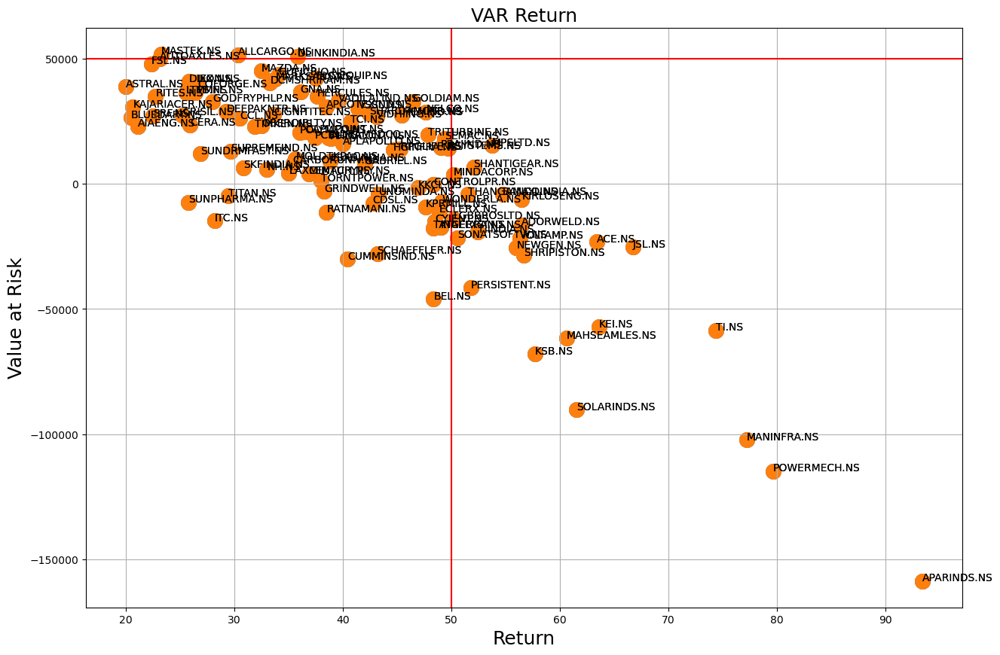

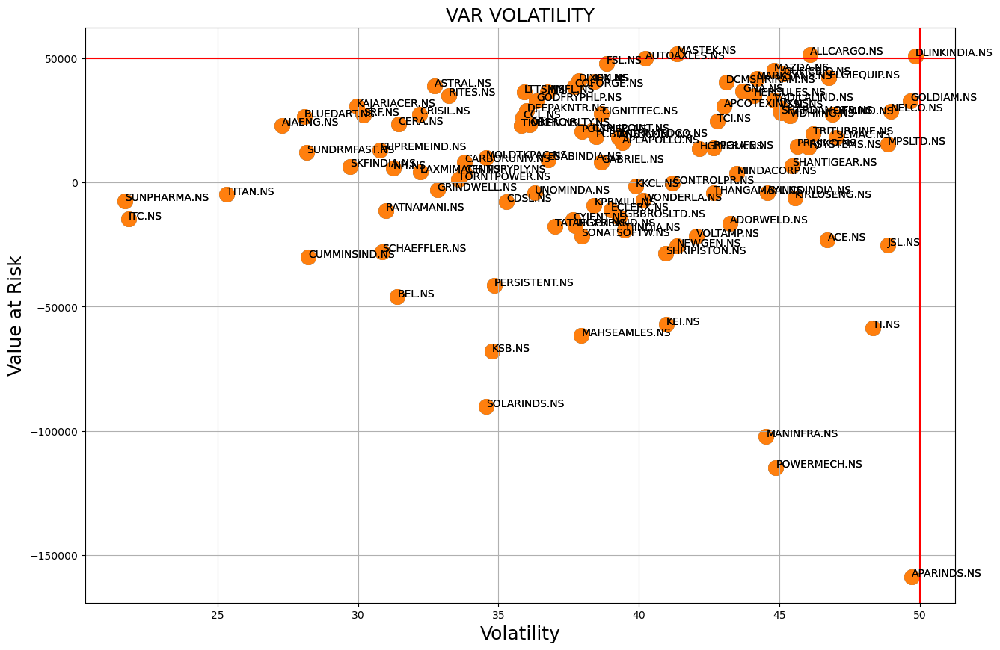

In [54]:
plt.figure(figsize=[15,10])
x= df3['Return%']
y = df3['Value at Risk']
annotations = df3["Ticker"]
plt.grid(True)
plt.title('VAR Return', fontsize=18, color='black')
plt.xlabel("Return",fontsize=18, color='black')
plt.ylabel("Value at Risk", fontsize=18, color='black') 
plt.scatter(x, y,s=200 )
for i, label in enumerate(annotations):
    plt.annotate(label, (x[i], y[i]))
plt.scatter(x, y,s=200 )
for i, label in enumerate(annotations):
    plt.annotate(label, (x[i], y[i]))
plt.axvline(x = 50, color = 'r', label = 'axvline - full height')
plt.axhline(y=50000, color='r', linestyle='-')
plt.show()

plt.figure(figsize=[15,10])
x= df3['Volatility%']
y = df3['Value at Risk']
annotations = df3["Ticker"]
plt.grid(True)
plt.title('VAR VOLATILITY', fontsize=18, color='black')
plt.xlabel("Volatility",fontsize=18, color='black')
plt.ylabel("Value at Risk", fontsize=18, color='black') 
plt.scatter(x, y,s=200 )
for i, label in enumerate(annotations):
    plt.annotate(label, (x[i], y[i]))
plt.scatter(x, y,s=200 )
for i, label in enumerate(annotations):
    plt.annotate(label, (x[i], y[i]))
plt.axvline(x = 50, color = 'r', label = 'axvline - full height')
plt.axhline(y=50000, color='r', linestyle='-')
plt.show()

In [55]:
len(df3)

105

In [56]:
df4 = df3.sort_values(by='Return%', ascending=False)

In [57]:
df4.head(40)

,level_0,index,Ticker,Cov_mar,Market_var,Beta,Volatility%,Return%,CV,Sharp Ratio,CAGR,MAXDD%,Value at Risk
0,1,119,APARINDS.NS,0.015236,0.021845,0.697473,49.707619,93.379926,53.231590,1.777996,154.095266,28.222426,-158635.907358
1,9,116,POWERMECH.NS,0.017513,0.021845,0.801712,44.880763,79.640752,56.354017,1.663090,123.108780,30.000625,-114694.370006
2,12,132,MANINFRA.NS,0.026407,0.021845,1.208859,44.536409,77.205456,57.685572,1.621268,116.195444,48.152470,-102254.087622
3,15,87,TI.NS,0.013297,0.021845,0.608725,48.345306,74.396953,64.982911,1.435443,110.216029,48.096195,-58468.206121
4,18,137,JSL.NS,0.022467,0.021845,1.028506,48.870835,66.745375,73.219807,1.263440,94.440770,55.167662,-25355.138612
5,21,32,KEI.NS,0.013988,0.021845,0.640349,40.985463,63.604815,64.437674,1.429893,88.738030,21.472188,-57166.513278
6,22,33,ACE.NS,0.023697,0.021845,1.084808,46.723038,63.372146,73.728036,1.249323,88.299997,36.268873,-23166.111212
7,23,19,SOLARINDS.NS,0.012060,0.021845,0.552095,34.563127,61.515336,56.186195,1.635134,84.840516,22.810511,-90261.201113
8,25,167,MAHSEAMLES.NS,0.016341,0.021845,0.748049,37.950403,60.602225,62.622128,1.465129,83.162656,34.398078,-61645.058564
9,29,27,KSB.NS,0.010256,0.021845,0.469505,34.767848,57.716176,60.239348,1.516234,77.767462,29.013796,-67987.961490


In [58]:
df4.tail(30)

,level_0,index,Ticker,Cov_mar,Market_var,Beta,Volatility%,Return%,CV,Sharp Ratio,CAGR,MAXDD%,Value at Risk
75,108,71,NH.NS,0.009740,0.021845,0.445862,31.254098,33.016140,94.663089,0.896399,39.057292,24.178865,5619.620008
76,110,94,OBEROIRLTY.NS,0.024999,0.021845,1.144394,36.115179,32.531656,111.015495,0.762329,38.386117,28.763880,23222.951011
77,111,163,MAZDA.NS,0.013411,0.021845,0.613911,44.821210,32.505017,137.890128,0.613661,38.349307,37.146346,45040.851822
78,112,30,TIMKEN.NS,0.011428,0.021845,0.523149,35.824183,31.922541,112.222217,0.751519,37.311213,24.489059,22912.462132
79,114,72,SKFINDIA.NS,0.012684,0.021845,0.580631,29.714145,30.853174,96.308226,0.870063,36.085798,24.793149,6489.545643
80,117,84,CCL.NS,0.015397,0.021845,0.704858,35.865863,30.533352,117.464543,0.711912,35.651847,36.649678,26154.281099
81,118,189,ALLCARGO.NS,0.018422,0.021845,0.843321,46.103187,30.336694,151.971691,0.549565,35.385698,47.181694,51510.290280
82,121,23,SUPREMEIND.NS,0.010663,0.021845,0.488130,30.790310,29.701620,103.665420,0.802253,34.529776,35.379228,13058.898428
83,122,7,TITAN.NS,0.020176,0.021845,0.923622,25.331436,29.458388,85.990573,0.965535,34.203394,28.627775,-4872.693308
84,123,77,DEEPAKNTR.NS,0.023604,0.021845,1.080532,36.007921,29.283911,122.961447,0.674405,33.969760,41.228339,28915.725737


In [59]:
df3.head(20)

,level_0,index,Ticker,Cov_mar,Market_var,Beta,Volatility%,Return%,CV,Sharp Ratio,CAGR,MAXDD%,Value at Risk
0,1,119,APARINDS.NS,0.015236,0.021845,0.697473,49.707619,93.379926,53.231590,1.777996,154.095266,28.222426,-158635.907358
1,9,116,POWERMECH.NS,0.017513,0.021845,0.801712,44.880763,79.640752,56.354017,1.663090,123.108780,30.000625,-114694.370006
2,12,132,MANINFRA.NS,0.026407,0.021845,1.208859,44.536409,77.205456,57.685572,1.621268,116.195444,48.152470,-102254.087622
3,15,87,TI.NS,0.013297,0.021845,0.608725,48.345306,74.396953,64.982911,1.435443,110.216029,48.096195,-58468.206121
4,18,137,JSL.NS,0.022467,0.021845,1.028506,48.870835,66.745375,73.219807,1.263440,94.440770,55.167662,-25355.138612
5,21,32,KEI.NS,0.013988,0.021845,0.640349,40.985463,63.604815,64.437674,1.429893,88.738030,21.472188,-57166.513278
6,22,33,ACE.NS,0.023697,0.021845,1.084808,46.723038,63.372146,73.728036,1.249323,88.299997,36.268873,-23166.111212
7,23,19,SOLARINDS.NS,0.012060,0.021845,0.552095,34.563127,61.515336,56.186195,1.635134,84.840516,22.810511,-90261.201113
8,25,167,MAHSEAMLES.NS,0.016341,0.021845,0.748049,37.950403,60.602225,62.622128,1.465129,83.162656,34.398078,-61645.058564
9,29,27,KSB.NS,0.010256,0.021845,0.469505,34.767848,57.716176,60.239348,1.516234,77.767462,29.013796,-67987.961490


In [60]:
df2.head(30)

,index,Ticker,Cov_mar,Market_var,Beta,Volatility%,Return%,CV,Sharp Ratio,CAGR,MAXDD%,Value at Risk
0,51,XPROINDIA.NS,0.017242,0.021845,0.789291,53.910457,129.072765,41.767492,2.301460,262.910397,49.866774,-511003.735482
1,119,APARINDS.NS,0.015236,0.021845,0.697473,49.707619,93.379926,53.231590,1.777996,154.095266,28.222426,-158635.907358
2,35,PGEL.NS,0.019744,0.021845,0.903860,50.980641,91.529595,55.698532,1.697303,149.443122,38.169383,-133632.102989
3,128,GOODLUCK.NS,0.019748,0.021845,0.904033,50.066230,91.286588,54.845110,1.723449,148.838510,38.299220,-143844.120436
4,79,GRAVITA.NS,0.023698,0.021845,1.084840,51.100833,86.807848,58.866605,1.600910,137.953952,38.160470,-101382.587574
5,8,JWL.NS,0.015793,0.021845,0.722981,54.746720,86.469052,63.313658,1.488108,137.150222,49.496642,-69939.169368
6,9,BLS.NS,0.022786,0.021845,1.043108,51.327260,85.574569,59.979572,1.569820,135.041249,38.641955,-94510.227312
7,115,PITTIENG.NS,0.018130,0.021845,0.829971,50.161826,84.445608,59.401343,1.583786,132.406188,31.922989,-98534.024383
8,101,ANGELONE.NS,0.022397,0.021845,1.025293,52.138757,80.193392,65.016276,1.442178,122.743720,48.550687,-60318.779893
9,116,POWERMECH.NS,0.017513,0.021845,0.801712,44.880763,79.640752,56.354017,1.663090,123.108780,30.000625,-114694.370006
